In [1]:
import torch 
from torch.utils.data import DataLoader, random_split
from torch import nn 
import torch.nn.functional as F
from torchvision import transforms, datasets
import os
from tqdm import tqdm

import matplotlib.pyplot as plt
from PIL import Image
import cv2

In [2]:
device = "cuda" if torch.cuda.is_available() else "cpu"

In [7]:
device

'cuda'

In [8]:
transform = transforms.Compose([
    transforms.Resize((256, 256)),  
    transforms.ToTensor()
])


In [9]:
class CustomDataset:
    def __init__(self, low_res_dir, high_res_dir, transform=None):

        # specify directories 
        self.low_res_dir = low_res_dir
        self.high_res_dir = high_res_dir
        self.transform = transform

        # turn them into sorted lists
        self.low_res_imgs = sorted(os.listdir(low_res_dir))
        self.high_res_imgs = sorted(os.listdir(high_res_dir))

    def __len__(self):
        return len(self.low_res_imgs)

    def __getitem__(self, idx):

        # define path to images according to index
        low_res_path = os.path.join(self.low_res_dir, self.low_res_imgs[idx])
        high_res_path = os.path.join(self.high_res_dir, self.high_res_imgs[idx])

        # open them using PIL and save into variable
        low_img = Image.open(low_res_path).convert("RGB")  
        high_img = Image.open(high_res_path).convert("RGB")

        # apply transformation for opened images 
        if self.transform:
            low_img = self.transform(low_img)
            high_img = self.transform(high_img)

        return low_img, high_img

In [13]:
dataset = CustomDataset(low_res_dir = "/kaggle/input/image-super-resolution/dataset/Raw Data/low_res",
                  high_res_dir = "/kaggle/input/image-super-resolution/dataset/Raw Data/high_res", 
                  transform=transform)

In [14]:
len(dataset)

855

In [15]:
def output(limit, dataset, name='low'):
    limit = limit
    num = 0
    for low_img, high_img in dataset:
        num += 1

        if name == "low":
            low_img = low_img.permute(1, 2, 0)
            plt.imshow(low_img)
            plt.show()

        elif name == "high":
            high_img = high_img.permute(1, 2, 0)
            plt.imshow(high_img)
            plt.show()

        else:
            raise ValueError("Choose name between 'low' or 'high'.")
    
        if num >= limit:
            break
        

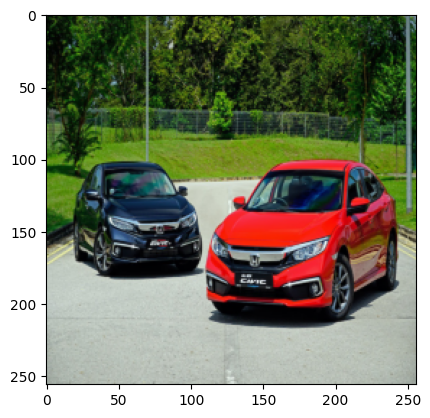

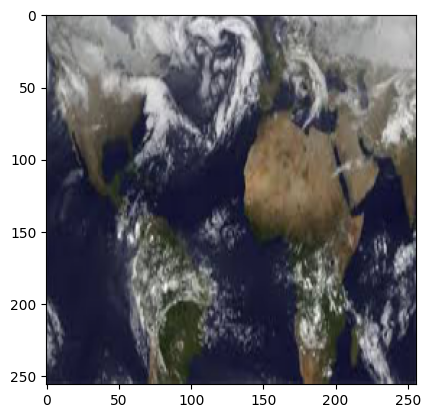

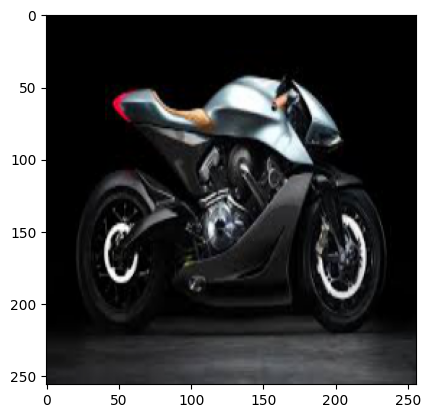

In [16]:
output(3, dataset, name='high')

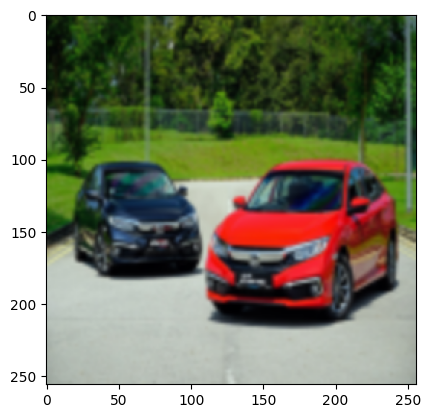

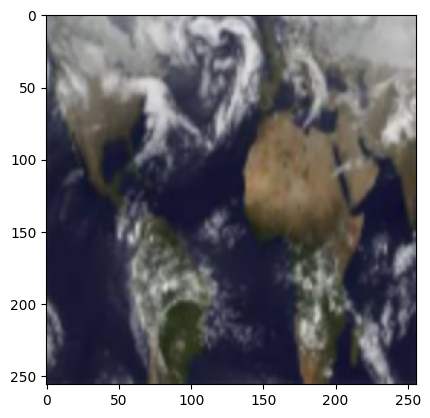

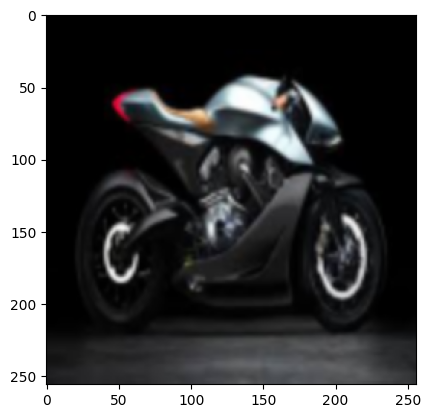

In [17]:
output(3, dataset, name='low')

In [18]:
def subplot_output(num_images, dataset):

    if num_images <= 1:
        num_images += 1
    
    fig, axis = plt.subplots(num_images, 2, figsize=(20, 20))
        
    num_images = num_images
    
    for i, (low_img, high_img) in enumerate(dataset):
        if i == num_images:  
            break
    
        low_img = low_img.permute(1, 2, 0) 
        high_img = high_img.permute(1, 2, 0)
    
        axis[i, 0].matshow(low_img)
        axis[i, 0].set_title("Low resolution image")
        axis[i, 0].axis("off")
    
    
        axis[i, 1].matshow(high_img)
        axis[i, 1].set_title("High resolution image")
        axis[i, 1].axis("off")
    
    plt.tight_layout()
    plt.show()


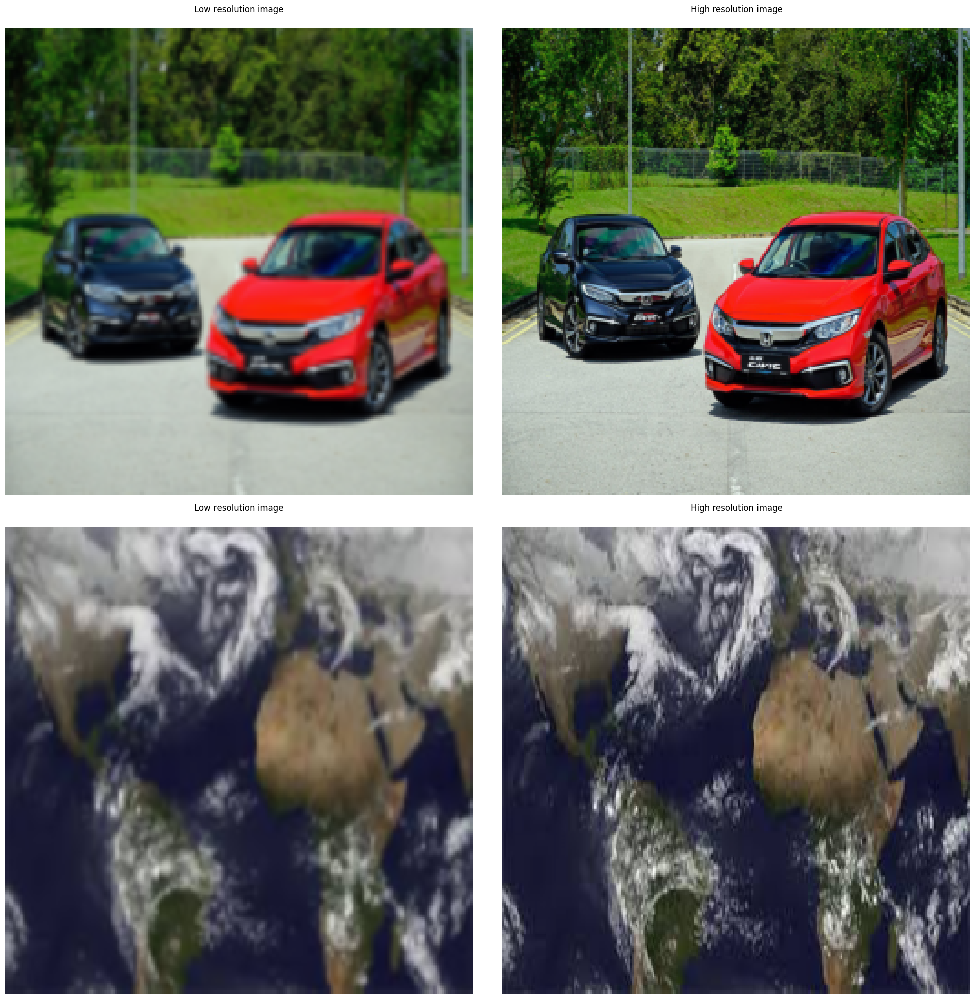

In [19]:
subplot_output(2, dataset)

In [20]:
train_ratio = 0.8

generator = torch.Generator(device=device)
train_dataset, test_dataset, val_dataset = random_split(dataset, [train_ratio, 0.9 - train_ratio, 0.9 - train_ratio])

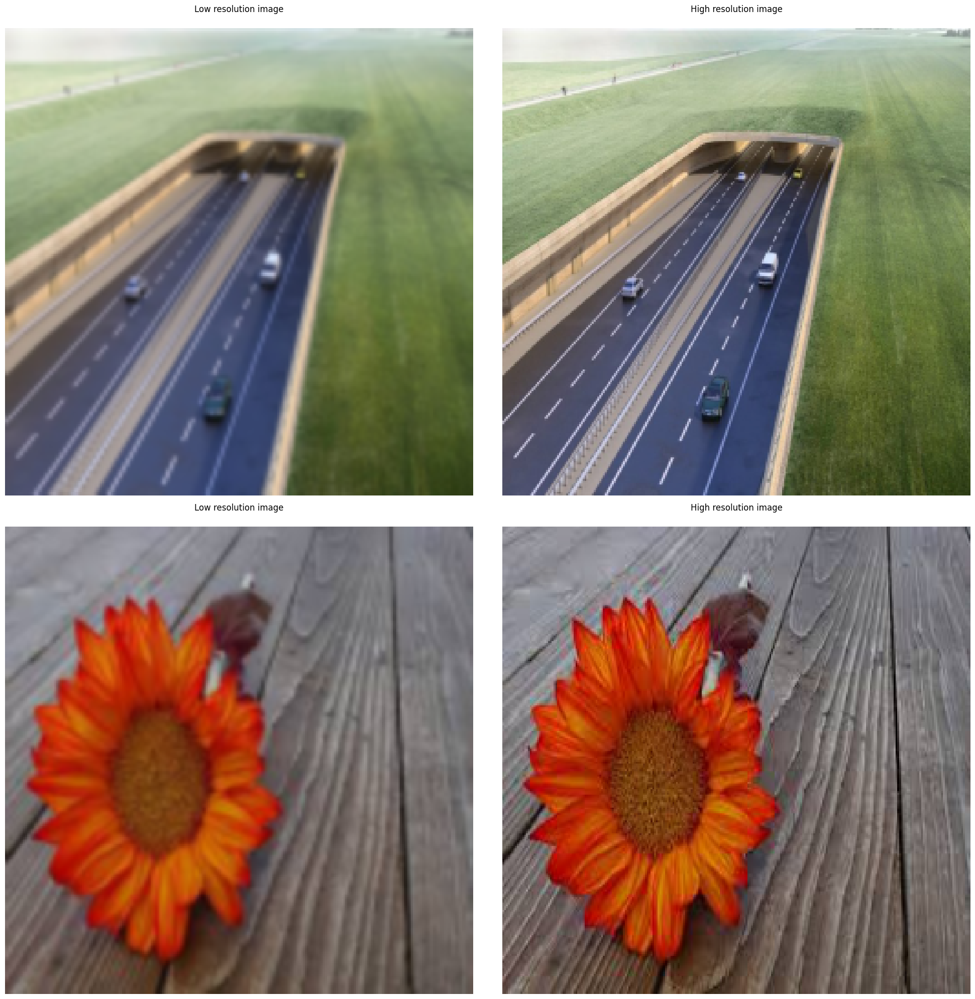

In [21]:
subplot_output(2, train_dataset)

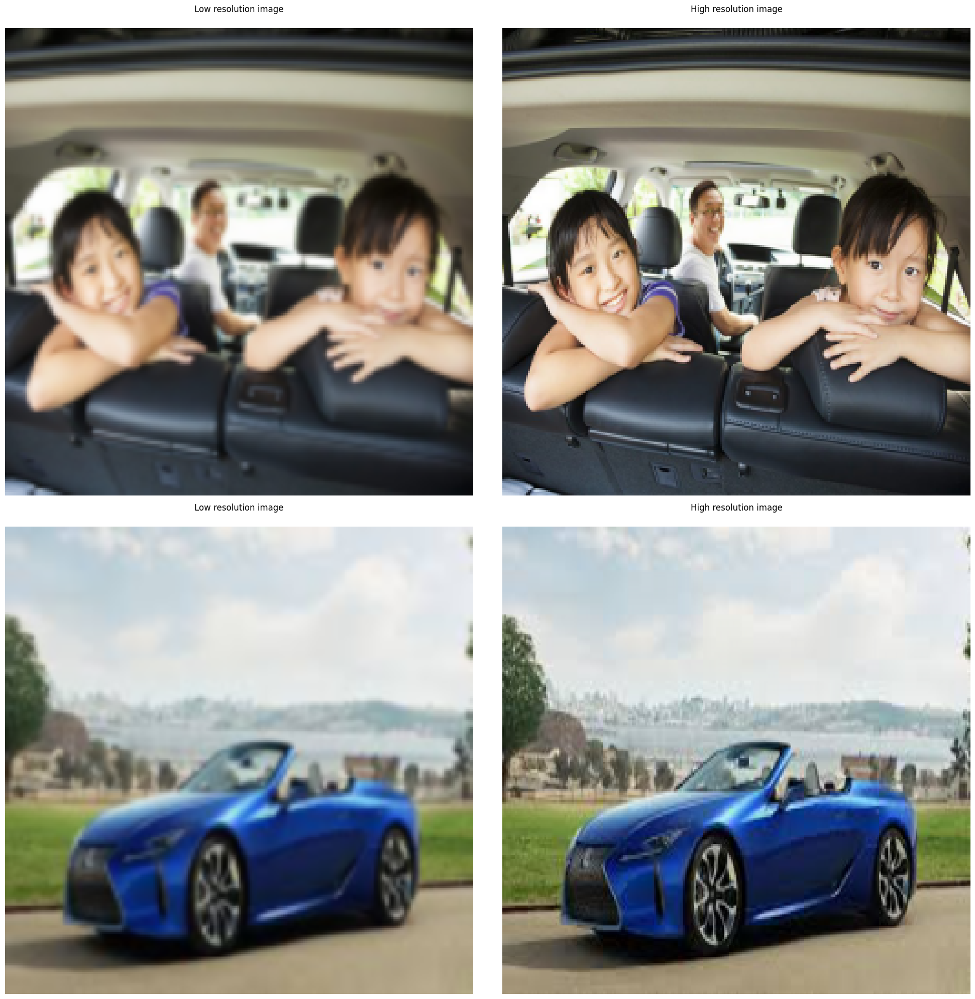

In [22]:
subplot_output(2, val_dataset)

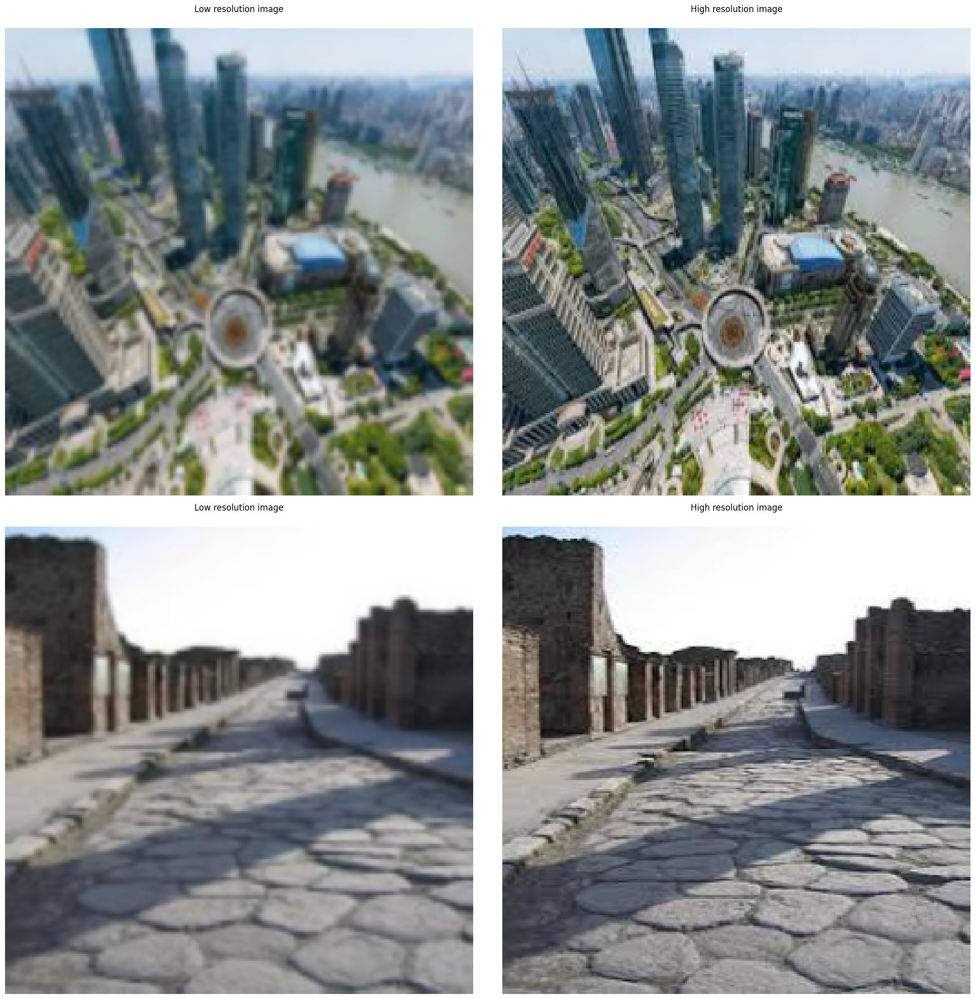

In [23]:
subplot_output(2, test_dataset)

In [24]:
batch_size = 16
train_dl = DataLoader(train_dataset, batch_size=batch_size, generator=torch.Generator(device = "cpu"))
val_dl = DataLoader(val_dataset, batch_size=batch_size, generator=torch.Generator(device = "cpu"))

In [94]:
# 2


import torch
import torch.nn as nn
import torch.nn.functional as F

class Autoencoder(nn.Module):
    def __init__(self):
        super().__init__()

        # Encoder

        # 3, 256, 256
        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, padding=1)
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.pool1_1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.bn1 = nn.BatchNorm2d(64)

        # 64, 64, 64

        self.conv2 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.pool2_1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.bn2 = nn.BatchNorm2d(128)

        # 128, 16, 16

        self.conv3 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.bn3 = nn.BatchNorm2d(256)

        # 256, 8, 8

        self.conv4 = nn.Conv2d(256, 512, kernel_size=3, padding=1)
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.pool4_1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.bn4 = nn.BatchNorm2d(512)

        # 512, 2, 2

        self.conv5 = nn.Conv2d(512, 1024, kernel_size=3, padding=1)
        self.pool5 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.pool5_1 = nn.MaxPool2d(kernel_size=2, stride=2)


        # 1024, 1, 1
  
        # Decoder
        self.deconv1 = nn.ConvTranspose2d(1024, 512, kernel_size=3, padding=1)
         # multiply by 2
        self.upsample1 = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)
        # multiply by 4
        self.upsample1_1 = nn.Upsample(scale_factor=4, mode='bilinear', align_corners=False)
        self.b_n1 = nn.BatchNorm2d(512)

        
        self.deconv2 = nn.ConvTranspose2d(1024, 256, kernel_size=3, padding=1)  # конкатенация увеличивает число каналов
        self.upsample2 = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)
        self.upsample2_1 = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)
        self.b_n2 = nn.BatchNorm2d(256)

        self.deconv3 = nn.ConvTranspose2d(512, 128, kernel_size=3, padding=1)  # аналогично
        self.upsample3 = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)
        self.upsample3_1 = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)
        self.b_n3 = nn.BatchNorm2d(128)

        # 256, 64 
        self.deconv4 = nn.ConvTranspose2d(256, 64, kernel_size=3, padding=1)
        self.upsample4 = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)
        self.upsample4_1 = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)
        self.b_n4 = nn.BatchNorm2d(64)

        self.deconv5 = nn.ConvTranspose2d(128, 64, kernel_size=3, padding=1)
        self.b_n5 = nn.BatchNorm2d(64)

        self.deconv6 = nn.ConvTranspose2d(64, 3, kernel_size=3, padding=1)
        self.b_n6 = nn.BatchNorm2d(3)
        

    def forward(self, x):
        # Encoder
        d1 = self.conv1(x)  # 3, 256, 256 -> 64, 256, 256
        out = F.leaky_relu(d1)
        out = self.pool1(out)  # 64, 128, 128
        out = F.leaky_relu(out)
        out = self.pool1_1(out) # 64, 64, 64
        out = self.bn1(out)

        d2 = self.conv2(out)  # 64, 64, 64 -> 128, 64, 64
        out = F.leaky_relu(d2)
        out = self.pool2(out)  # 128, 32, 32
        out = F.leaky_relu(out)
        out = self.pool2_1(out) # 128, 16, 16
        out = self.bn2(out)

        d3 = self.conv3(out)  # 128, 16, 16 -> 256, 16, 16
        out = F.leaky_relu(d3)
        out = self.pool3(out)  # 256, 8, 8
        out = self.bn3(out)

        d4 = self.conv4(out)  # 256, 8, 8 -> 512, 8, 8
        out = F.leaky_relu(d4)
        out = self.pool4(out)  # 512, 4, 4
        out = F.leaky_relu(out)
        out = self.pool4_1(out) # 512, 2, 2
        out = self.bn4(out)

        d5 = self.conv5(out)  # 512, 2, 2 -> 1024, 2, 2
        out = F.leaky_relu(d5)
        encoded = self.pool5(out)  #  1024, 2, 2 - > 1024, 1, 1
    
        # Decoder
        
        u1 = self.deconv1(encoded)  # 1024, 1, 1 -> 512, 1, 1
        u1 = F.leaky_relu(u1)
        u1 = self.upsample1(u1)  # 512, 2, 2
        u1 = self.upsample1_1(u1) # 512, 8, 8
        u1 = self.b_n1(u1)

        out = torch.cat((d4, u1), dim=1)  # 512 + 512 = 1024, 8, 8

        u2 = self.deconv2(out)  # 1024, 8, 8 -> 256, 8, 8
        u2 = F.leaky_relu(u2)
        u2 = self.upsample2(u2)  # 256, 16, 16
        u2 = self.b_n2(u2)

        out = torch.cat((d3, u2), dim=1)  # 256 + 256 = 512, 16, 16 

        u3 = self.deconv3(out)  # 512, 16, 16 -> 128, 16, 16
        u3 = F.leaky_relu(u3)
        u3 = self.upsample3(u3)  # 128, 32, 32
        u3 = self.upsample3_1(u3)  # 128, 64, 64
        
        u3 = self.b_n3(u3)

        out = torch.cat((d2, u3), dim=1)  # 128 + 128 = 256, 64, 64

        u4 = self.deconv4(out)  # 256, 64, 64 -> 64, 64, 64
        u4 = F.leaky_relu(u4)
        u4 = self.upsample4(u4)  # 64, 128, 128
        u4 = self.upsample4_1(u4)  # 64, 256, 256
        u4 = self.b_n4(u4)

        out = torch.cat((d1, u4), dim=1)  # 64 + 64 = 128, 256, 256

        u5 = self.deconv5(out)  # 128, 256, 256 -> 64, 256, 256
        u5 = F.leaky_relu(u5)
        u5 = self.b_n5(u5)

        u6 = self.deconv6(u5)  # 64, 256, 256 -> 3, 256, 256
        u6 = F.leaky_relu(u6)
        decoded = self.b_n6(u6)

        return decoded

    def predict(self, low_img):
        self.eval()

        with torch.no_grad():
            if len(low_img.shape) == 3:
                low_img = low_img.unsqueeze(0)
                
            high_img = self.forward(low_img)

        return high_img


model = Autoencoder()
model = model.to(device)
model


Autoencoder(
  (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (pool1_1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (pool2_1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv4): Conv2d(256, 512, kernel_size=(3, 3), str

In [27]:
!pip install -q torchsummary

In [28]:
from torchsummary import summary
summary(model, input_size=(3, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,792
         MaxPool2d-2         [-1, 64, 128, 128]               0
         MaxPool2d-3           [-1, 64, 64, 64]               0
       BatchNorm2d-4           [-1, 64, 64, 64]             128
            Conv2d-5          [-1, 128, 64, 64]          73,856
         MaxPool2d-6          [-1, 128, 32, 32]               0
         MaxPool2d-7          [-1, 128, 16, 16]               0
       BatchNorm2d-8          [-1, 128, 16, 16]             256
            Conv2d-9          [-1, 256, 16, 16]         295,168
        MaxPool2d-10            [-1, 256, 8, 8]               0
      BatchNorm2d-11            [-1, 256, 8, 8]             512
           Conv2d-12            [-1, 512, 8, 8]       1,180,160
        MaxPool2d-13            [-1, 512, 4, 4]               0
        MaxPool2d-14            [-1, 51

In [30]:
import time

def train(model, optimizer, loss_fn, train_dl, val_dl,
          metrics=None, metrics_name=None, epochs=20, device='cpu', task='regression'):
    
    print('train() called: model=%s, opt=%s(lr=%f), epochs=%d, device=%s\n' % \
          (type(model).__name__, type(optimizer).__name__,
           optimizer.param_groups[0]['lr'], epochs, device))

    metrics = metrics if metrics else []
    metrics_name = metrics_name if metrics_name else [metric.__name__ for metric in metrics]

    history = {} 
    history['loss'] = []
    history['val_loss'] = []
    for name in metrics_name:
        history[name] = []
        history[f'val_{name}'] = []

    start_time_train = time.time()

    for epoch in range(epochs):

        # --- TRAIN AND EVALUATE ON TRAINING SET -----------------------------
        start_time_epoch = time.time()

        model.train()
        history_train = {name: 0 for name in ['loss']+metrics_name}

        for batch in tqdm(train_dl):
            x    = batch[0].to(device)
            y    = batch[1].to(device)
            y_pred = model(x)
            loss = loss_fn(y_pred, y)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            y_pred = y_pred.detach().cpu().numpy()
            y = y.detach().cpu().numpy()


            history_train['loss'] += loss.item() * x.size(0)
            for name, func in zip(metrics_name, metrics):
                try:
                    history_train[name] += func(y, y_pred) * x.size(0)
                except:
                    if task == 'binary': y_pred_ = y_pred.round()
                    elif task == 'multiclass': y_pred_ = y_pred.argmax(axis=-1)
                    history_train[name] += func(y, y_pred_) * x.size(0)

        for name in history_train:
            history_train[name] /= len(train_dl.dataset)
e

        # --- EVALUATE ON VALIDATION SET -------------------------------------
        model.eval()
        history_val = {'val_' + name: 0 for name in metrics_name+['loss']}

        with torch.no_grad():
            for batch in tqdm(val_dl):
                x    = batch[0].to(device)
                y    = batch[1].to(device)
                y_pred = model(x)
                loss = loss_fn(y_pred, y)

                y_pred = y_pred.cpu().numpy()
                y = y.cpu().numpy()

                history_val['val_loss'] += loss.item() * x.size(0)
                for name, func in zip(metrics_name, metrics):
                    try:
                        history_val['val_'+name] += func(y, y_pred) * x.size(0)
                    except:
                        if task == 'binary': y_pred_ = y_pred.round()
                        elif task == 'multiclass': y_pred_ = y_pred.argmax(axis=-1)

                        history_val['val_'+name] += func(y, y_pred_) * x.size(0)

        for name in history_val:
            history_val[name] /= len(val_dl.dataset)

        # PRINTING RESULTS

        end_time_epoch = time.time()

        for name in history_train:
            history[name].append(history_train[name])
            history['val_'+name].append(history_val['val_'+name])

        total_time_epoch = end_time_epoch - start_time_epoch

        print(f'Epoch {epoch+1:4d} {total_time_epoch:4.0f}sec', end='\t')
        for name in history_train:
            print(f'{name}: {history[name][-1]:10.3g}', end='\t')
            print(f"val_{name}: {history['val_'+name][-1]:10.3g}", end='\t')
        print()

    # END OF TRAINING LOOP

    end_time_train       = time.time()
    total_time_train     = end_time_train - start_time_train
    print()
    print('Time total:     %5.2f sec' % (total_time_train))

    return history

In [31]:
loss = nn.MSELoss()
# optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
optimizer = torch.optim.RMSprop(model.parameters(), lr=1e-3, momentum=0.9)

In [32]:
from skimage.metrics import peak_signal_noise_ratio as psnr

# peak_signal_noise_ratio as psnr - shows quality of restored image
# if psnr > 20, then quality is low
# if 20 > psnr > 30, then quality is medium
# if psnr > 30 (esp 40-50), then quality is high


history = train(model, optimizer, loss, train_dl, val_dl,
                epochs=100,
                metrics=[psnr],
                device=device,
                task='regression')

train() called: model=Autoencoder, opt=RMSprop(lr=0.001000), epochs=100, device=cuda



100%|██████████| 6/6 [00:02<00:00,  2.70it/s]


Epoch    1   24sec	loss:      0.235	val_loss:     0.0189	peak_signal_noise_ratio:       10.2	val_peak_signal_noise_ratio:       17.2	


100%|██████████| 6/6 [00:01<00:00,  4.43it/s]


Epoch    2   14sec	loss:    0.00857	val_loss:     0.0145	peak_signal_noise_ratio:       20.8	val_peak_signal_noise_ratio:       18.4	


100%|██████████| 6/6 [00:01<00:00,  5.31it/s]


Epoch    3   14sec	loss:    0.00806	val_loss:     0.0155	peak_signal_noise_ratio:       21.1	val_peak_signal_noise_ratio:       18.1	


100%|██████████| 6/6 [00:01<00:00,  5.56it/s]


Epoch    4   13sec	loss:    0.00758	val_loss:     0.0159	peak_signal_noise_ratio:       21.4	val_peak_signal_noise_ratio:         18	


100%|██████████| 6/6 [00:01<00:00,  5.45it/s]


Epoch    5   13sec	loss:    0.00701	val_loss:     0.0149	peak_signal_noise_ratio:       21.7	val_peak_signal_noise_ratio:       18.3	


100%|██████████| 6/6 [00:01<00:00,  5.84it/s]


Epoch    6   13sec	loss:    0.00653	val_loss:     0.0116	peak_signal_noise_ratio:       22.1	val_peak_signal_noise_ratio:       19.4	


100%|██████████| 6/6 [00:01<00:00,  5.57it/s]


Epoch    7   13sec	loss:    0.00581	val_loss:     0.0113	peak_signal_noise_ratio:       22.6	val_peak_signal_noise_ratio:       19.5	


100%|██████████| 6/6 [00:01<00:00,  5.67it/s]


Epoch    8   13sec	loss:    0.00547	val_loss:     0.0129	peak_signal_noise_ratio:       22.9	val_peak_signal_noise_ratio:       18.9	


100%|██████████| 6/6 [00:01<00:00,  5.71it/s]


Epoch    9   13sec	loss:    0.00531	val_loss:    0.00847	peak_signal_noise_ratio:       23.1	val_peak_signal_noise_ratio:       20.7	


100%|██████████| 6/6 [00:01<00:00,  5.20it/s]


Epoch   10   14sec	loss:    0.00518	val_loss:    0.00967	peak_signal_noise_ratio:       23.2	val_peak_signal_noise_ratio:       20.2	


100%|██████████| 6/6 [00:01<00:00,  5.56it/s]


Epoch   11   13sec	loss:    0.00502	val_loss:    0.00476	peak_signal_noise_ratio:       23.4	val_peak_signal_noise_ratio:       23.2	


100%|██████████| 6/6 [00:01<00:00,  5.43it/s]


Epoch   12   13sec	loss:    0.00492	val_loss:    0.00749	peak_signal_noise_ratio:       23.5	val_peak_signal_noise_ratio:       21.3	


100%|██████████| 6/6 [00:01<00:00,  5.68it/s]


Epoch   13   13sec	loss:    0.00478	val_loss:    0.00786	peak_signal_noise_ratio:       23.7	val_peak_signal_noise_ratio:       21.1	


100%|██████████| 6/6 [00:01<00:00,  5.38it/s]


Epoch   14   14sec	loss:    0.00475	val_loss:    0.00351	peak_signal_noise_ratio:       23.7	val_peak_signal_noise_ratio:       24.6	


100%|██████████| 6/6 [00:01<00:00,  5.14it/s]


Epoch   15   13sec	loss:    0.00465	val_loss:    0.00458	peak_signal_noise_ratio:       23.8	val_peak_signal_noise_ratio:       23.4	


100%|██████████| 6/6 [00:01<00:00,  5.55it/s]


Epoch   16   13sec	loss:    0.00459	val_loss:    0.00236	peak_signal_noise_ratio:       23.9	val_peak_signal_noise_ratio:       26.3	


100%|██████████| 6/6 [00:01<00:00,  5.01it/s]


Epoch   17   14sec	loss:    0.00456	val_loss:    0.00419	peak_signal_noise_ratio:         24	val_peak_signal_noise_ratio:       23.8	


100%|██████████| 6/6 [00:01<00:00,  5.36it/s]


Epoch   18   13sec	loss:    0.00454	val_loss:    0.00521	peak_signal_noise_ratio:         24	val_peak_signal_noise_ratio:       22.8	


100%|██████████| 6/6 [00:01<00:00,  5.56it/s]


Epoch   19   13sec	loss:    0.00448	val_loss:    0.00362	peak_signal_noise_ratio:       24.1	val_peak_signal_noise_ratio:       24.4	


100%|██████████| 6/6 [00:01<00:00,  5.20it/s]


Epoch   20   13sec	loss:    0.00464	val_loss:    0.00523	peak_signal_noise_ratio:       23.9	val_peak_signal_noise_ratio:       22.8	


100%|██████████| 6/6 [00:01<00:00,  5.08it/s]


Epoch   21   13sec	loss:    0.00448	val_loss:    0.00625	peak_signal_noise_ratio:       24.1	val_peak_signal_noise_ratio:       22.1	


100%|██████████| 6/6 [00:01<00:00,  5.56it/s]


Epoch   22   13sec	loss:    0.00441	val_loss:    0.00555	peak_signal_noise_ratio:       24.2	val_peak_signal_noise_ratio:       22.6	


100%|██████████| 6/6 [00:01<00:00,  5.69it/s]


Epoch   23   13sec	loss:    0.00437	val_loss:      0.002	peak_signal_noise_ratio:       24.2	val_peak_signal_noise_ratio:         27	


100%|██████████| 6/6 [00:01<00:00,  5.28it/s]


Epoch   24   13sec	loss:    0.00435	val_loss:    0.00205	peak_signal_noise_ratio:       24.2	val_peak_signal_noise_ratio:       26.9	


100%|██████████| 6/6 [00:01<00:00,  5.74it/s]


Epoch   25   13sec	loss:    0.00437	val_loss:    0.00157	peak_signal_noise_ratio:       24.2	val_peak_signal_noise_ratio:       28.1	


100%|██████████| 6/6 [00:01<00:00,  5.54it/s]


Epoch   26   13sec	loss:     0.0044	val_loss:    0.00191	peak_signal_noise_ratio:       24.2	val_peak_signal_noise_ratio:       27.2	


100%|██████████| 6/6 [00:01<00:00,  5.65it/s]


Epoch   27   13sec	loss:    0.00433	val_loss:     0.0036	peak_signal_noise_ratio:       24.2	val_peak_signal_noise_ratio:       24.4	


100%|██████████| 6/6 [00:01<00:00,  5.30it/s]


Epoch   28   13sec	loss:    0.00429	val_loss:    0.00135	peak_signal_noise_ratio:       24.3	val_peak_signal_noise_ratio:       28.8	


100%|██████████| 6/6 [00:01<00:00,  5.50it/s]


Epoch   29   14sec	loss:    0.00423	val_loss:    0.00151	peak_signal_noise_ratio:       24.4	val_peak_signal_noise_ratio:       28.3	


100%|██████████| 6/6 [00:01<00:00,  5.69it/s]


Epoch   30   13sec	loss:    0.00422	val_loss:     0.0017	peak_signal_noise_ratio:       24.4	val_peak_signal_noise_ratio:       27.7	


100%|██████████| 6/6 [00:01<00:00,  5.14it/s]


Epoch   31   14sec	loss:     0.0042	val_loss:    0.00157	peak_signal_noise_ratio:       24.4	val_peak_signal_noise_ratio:       28.1	


100%|██████████| 6/6 [00:01<00:00,  5.21it/s]


Epoch   32   13sec	loss:    0.00418	val_loss:    0.00171	peak_signal_noise_ratio:       24.4	val_peak_signal_noise_ratio:       27.7	


100%|██████████| 6/6 [00:01<00:00,  5.52it/s]


Epoch   33   13sec	loss:     0.0042	val_loss:    0.00163	peak_signal_noise_ratio:       24.4	val_peak_signal_noise_ratio:       27.9	


100%|██████████| 6/6 [00:01<00:00,  5.34it/s]


Epoch   34   13sec	loss:    0.00417	val_loss:    0.00207	peak_signal_noise_ratio:       24.4	val_peak_signal_noise_ratio:       26.9	


100%|██████████| 6/6 [00:01<00:00,  5.05it/s]


Epoch   35   13sec	loss:    0.00414	val_loss:    0.00147	peak_signal_noise_ratio:       24.5	val_peak_signal_noise_ratio:       28.4	


100%|██████████| 6/6 [00:01<00:00,  5.28it/s]


Epoch   36   14sec	loss:    0.00414	val_loss:     0.0017	peak_signal_noise_ratio:       24.5	val_peak_signal_noise_ratio:       27.7	


100%|██████████| 6/6 [00:01<00:00,  5.04it/s]


Epoch   37   13sec	loss:    0.00417	val_loss:     0.0023	peak_signal_noise_ratio:       24.4	val_peak_signal_noise_ratio:       26.4	


100%|██████████| 6/6 [00:01<00:00,  5.56it/s]


Epoch   38   14sec	loss:    0.00413	val_loss:    0.00167	peak_signal_noise_ratio:       24.5	val_peak_signal_noise_ratio:       27.8	


100%|██████████| 6/6 [00:01<00:00,  5.61it/s]


Epoch   39   13sec	loss:    0.00412	val_loss:    0.00153	peak_signal_noise_ratio:       24.5	val_peak_signal_noise_ratio:       28.2	


100%|██████████| 6/6 [00:01<00:00,  4.54it/s]


Epoch   40   14sec	loss:    0.00412	val_loss:    0.00137	peak_signal_noise_ratio:       24.5	val_peak_signal_noise_ratio:       28.7	


100%|██████████| 6/6 [00:01<00:00,  5.75it/s]


Epoch   41   13sec	loss:     0.0041	val_loss:    0.00141	peak_signal_noise_ratio:       24.5	val_peak_signal_noise_ratio:       28.6	


100%|██████████| 6/6 [00:01<00:00,  5.70it/s]


Epoch   42   13sec	loss:    0.00409	val_loss:    0.00146	peak_signal_noise_ratio:       24.6	val_peak_signal_noise_ratio:       28.4	


100%|██████████| 6/6 [00:01<00:00,  5.57it/s]


Epoch   43   13sec	loss:    0.00408	val_loss:    0.00179	peak_signal_noise_ratio:       24.6	val_peak_signal_noise_ratio:       27.5	


100%|██████████| 6/6 [00:01<00:00,  5.38it/s]


Epoch   44   13sec	loss:    0.00408	val_loss:    0.00149	peak_signal_noise_ratio:       24.6	val_peak_signal_noise_ratio:       28.3	


100%|██████████| 6/6 [00:01<00:00,  5.81it/s]


Epoch   45   14sec	loss:    0.00407	val_loss:    0.00296	peak_signal_noise_ratio:       24.6	val_peak_signal_noise_ratio:       25.3	


100%|██████████| 6/6 [00:01<00:00,  5.52it/s]


Epoch   46   13sec	loss:    0.00409	val_loss:    0.00164	peak_signal_noise_ratio:       24.6	val_peak_signal_noise_ratio:       27.9	


100%|██████████| 6/6 [00:01<00:00,  5.62it/s]


Epoch   47   13sec	loss:    0.00406	val_loss:    0.00194	peak_signal_noise_ratio:       24.6	val_peak_signal_noise_ratio:       27.2	


100%|██████████| 6/6 [00:01<00:00,  5.39it/s]


Epoch   48   14sec	loss:    0.00406	val_loss:    0.00142	peak_signal_noise_ratio:       24.6	val_peak_signal_noise_ratio:       28.5	


100%|██████████| 6/6 [00:01<00:00,  5.57it/s]


Epoch   49   13sec	loss:    0.00405	val_loss:    0.00211	peak_signal_noise_ratio:       24.6	val_peak_signal_noise_ratio:       26.8	


100%|██████████| 6/6 [00:01<00:00,  5.62it/s]


Epoch   50   14sec	loss:    0.00406	val_loss:    0.00132	peak_signal_noise_ratio:       24.6	val_peak_signal_noise_ratio:       28.8	


100%|██████████| 6/6 [00:01<00:00,  5.19it/s]


Epoch   51   13sec	loss:    0.00404	val_loss:    0.00156	peak_signal_noise_ratio:       24.6	val_peak_signal_noise_ratio:       28.1	


100%|██████████| 6/6 [00:01<00:00,  4.95it/s]


Epoch   52   13sec	loss:    0.00404	val_loss:    0.00145	peak_signal_noise_ratio:       24.6	val_peak_signal_noise_ratio:       28.4	


100%|██████████| 6/6 [00:01<00:00,  5.61it/s]


Epoch   53   13sec	loss:    0.00403	val_loss:    0.00133	peak_signal_noise_ratio:       24.6	val_peak_signal_noise_ratio:       28.8	


100%|██████████| 6/6 [00:01<00:00,  4.87it/s]


Epoch   54   14sec	loss:    0.00402	val_loss:    0.00169	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:       27.8	


100%|██████████| 6/6 [00:01<00:00,  5.66it/s]


Epoch   55   13sec	loss:    0.00402	val_loss:    0.00158	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:         28	


100%|██████████| 6/6 [00:01<00:00,  5.67it/s]


Epoch   56   13sec	loss:    0.00401	val_loss:     0.0013	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:       28.9	


100%|██████████| 6/6 [00:01<00:00,  5.58it/s]


Epoch   57   13sec	loss:      0.004	val_loss:    0.00159	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:         28	


100%|██████████| 6/6 [00:01<00:00,  5.31it/s]


Epoch   58   13sec	loss:    0.00401	val_loss:    0.00158	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:       28.1	


100%|██████████| 6/6 [00:01<00:00,  5.45it/s]


Epoch   59   13sec	loss:    0.00401	val_loss:    0.00123	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:       29.2	


100%|██████████| 6/6 [00:01<00:00,  5.68it/s]


Epoch   60   13sec	loss:      0.004	val_loss:    0.00116	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:       29.4	


100%|██████████| 6/6 [00:01<00:00,  5.43it/s]


Epoch   61   13sec	loss:    0.00398	val_loss:    0.00129	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:         29	


100%|██████████| 6/6 [00:01<00:00,  5.56it/s]


Epoch   62   13sec	loss:    0.00398	val_loss:    0.00125	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:       29.1	


100%|██████████| 6/6 [00:01<00:00,  5.59it/s]


Epoch   63   13sec	loss:    0.00398	val_loss:    0.00107	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:       29.8	


100%|██████████| 6/6 [00:01<00:00,  5.61it/s]


Epoch   64   13sec	loss:    0.00397	val_loss:    0.00115	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:       29.5	


100%|██████████| 6/6 [00:01<00:00,  5.51it/s]


Epoch   65   13sec	loss:    0.00397	val_loss:    0.00129	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:         29	


100%|██████████| 6/6 [00:01<00:00,  5.79it/s]


Epoch   66   13sec	loss:    0.00396	val_loss:    0.00148	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:       28.3	


100%|██████████| 6/6 [00:01<00:00,  5.65it/s]


Epoch   67   13sec	loss:    0.00396	val_loss:    0.00203	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:       26.9	


100%|██████████| 6/6 [00:01<00:00,  5.33it/s]


Epoch   68   13sec	loss:    0.00397	val_loss:    0.00135	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:       28.7	


100%|██████████| 6/6 [00:01<00:00,  5.54it/s]


Epoch   69   13sec	loss:    0.00398	val_loss:    0.00155	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:       28.1	


100%|██████████| 6/6 [00:01<00:00,  5.64it/s]


Epoch   70   13sec	loss:    0.00397	val_loss:    0.00133	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:       28.8	


100%|██████████| 6/6 [00:01<00:00,  5.64it/s]


Epoch   71   13sec	loss:    0.00396	val_loss:    0.00212	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:       26.8	


100%|██████████| 6/6 [00:01<00:00,  5.73it/s]


Epoch   72   13sec	loss:    0.00395	val_loss:    0.00173	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:       27.6	


100%|██████████| 6/6 [00:01<00:00,  5.66it/s]


Epoch   73   13sec	loss:    0.00396	val_loss:    0.00325	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       24.9	


100%|██████████| 6/6 [00:01<00:00,  5.82it/s]


Epoch   74   13sec	loss:    0.00397	val_loss:    0.00106	peak_signal_noise_ratio:       24.7	val_peak_signal_noise_ratio:       29.8	


100%|██████████| 6/6 [00:01<00:00,  5.75it/s]


Epoch   75   13sec	loss:    0.00395	val_loss:    0.00149	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       28.3	


100%|██████████| 6/6 [00:01<00:00,  4.78it/s]


Epoch   76   13sec	loss:    0.00394	val_loss:    0.00142	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       28.5	


100%|██████████| 6/6 [00:01<00:00,  4.99it/s]


Epoch   77   15sec	loss:    0.00394	val_loss:    0.00124	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       29.1	


100%|██████████| 6/6 [00:01<00:00,  5.81it/s]


Epoch   78   13sec	loss:    0.00394	val_loss:    0.00127	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:         29	


100%|██████████| 6/6 [00:01<00:00,  5.57it/s]


Epoch   79   13sec	loss:    0.00394	val_loss:    0.00117	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       29.4	


100%|██████████| 6/6 [00:01<00:00,  5.32it/s]


Epoch   80   13sec	loss:    0.00393	val_loss:    0.00119	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       29.3	


100%|██████████| 6/6 [00:01<00:00,  5.75it/s]


Epoch   81   13sec	loss:    0.00394	val_loss:     0.0457	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       24.1	


100%|██████████| 6/6 [00:01<00:00,  5.59it/s]


Epoch   82   13sec	loss:    0.00393	val_loss:    0.00123	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       29.2	


100%|██████████| 6/6 [00:01<00:00,  5.60it/s]


Epoch   83   13sec	loss:    0.00394	val_loss:    0.00205	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       27.6	


100%|██████████| 6/6 [00:01<00:00,  5.72it/s]


Epoch   84   14sec	loss:    0.00394	val_loss:     0.0014	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       28.6	


100%|██████████| 6/6 [00:01<00:00,  5.59it/s]


Epoch   85   13sec	loss:    0.00393	val_loss:     0.0014	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       28.6	


100%|██████████| 6/6 [00:01<00:00,  5.95it/s]


Epoch   86   13sec	loss:    0.00393	val_loss:    0.00156	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       28.1	


100%|██████████| 6/6 [00:01<00:00,  5.71it/s]


Epoch   87   13sec	loss:    0.00392	val_loss:    0.00116	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       29.4	


100%|██████████| 6/6 [00:01<00:00,  4.84it/s]


Epoch   88   13sec	loss:    0.00392	val_loss:    0.00122	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       29.2	


100%|██████████| 6/6 [00:01<00:00,  5.94it/s]


Epoch   89   13sec	loss:    0.00392	val_loss:    0.00106	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       29.9	


100%|██████████| 6/6 [00:01<00:00,  5.84it/s]


Epoch   90   13sec	loss:    0.00392	val_loss:    0.00119	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       29.3	


100%|██████████| 6/6 [00:01<00:00,  5.59it/s]


Epoch   91   13sec	loss:    0.00392	val_loss:    0.00122	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       29.2	


100%|██████████| 6/6 [00:01<00:00,  5.45it/s]


Epoch   92   13sec	loss:    0.00392	val_loss:    0.00147	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       28.4	


100%|██████████| 6/6 [00:01<00:00,  5.25it/s]


Epoch   93   14sec	loss:    0.00392	val_loss:    0.00179	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       27.5	


100%|██████████| 6/6 [00:01<00:00,  5.61it/s]


Epoch   94   13sec	loss:    0.00392	val_loss:    0.00161	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:         28	


100%|██████████| 6/6 [00:01<00:00,  5.59it/s]


Epoch   95   13sec	loss:    0.00391	val_loss:     0.0017	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       27.9	


100%|██████████| 6/6 [00:01<00:00,  4.89it/s]


Epoch   96   13sec	loss:    0.00391	val_loss:    0.00145	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       28.4	


100%|██████████| 6/6 [00:01<00:00,  5.60it/s]


Epoch   97   13sec	loss:    0.00391	val_loss:    0.00141	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       28.5	


100%|██████████| 6/6 [00:01<00:00,  5.66it/s]


Epoch   98   13sec	loss:    0.00391	val_loss:    0.00145	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       28.4	


100%|██████████| 6/6 [00:01<00:00,  5.50it/s]


Epoch   99   13sec	loss:     0.0039	val_loss:    0.00135	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       28.7	


100%|██████████| 6/6 [00:01<00:00,  5.65it/s]

Epoch  100   13sec	loss:     0.0039	val_loss:    0.00151	peak_signal_noise_ratio:       24.8	val_peak_signal_noise_ratio:       28.2	

Time total:     1343.25 sec


In [72]:
def show_metrics(history, name):
    
    plt.plot(history[name], label="train")
    plt.plot(history["val_" + name], label="validation")
    plt.xlabel(name)
    plt.ylabel("Epochs")
    plt.legend()
    plt.show()

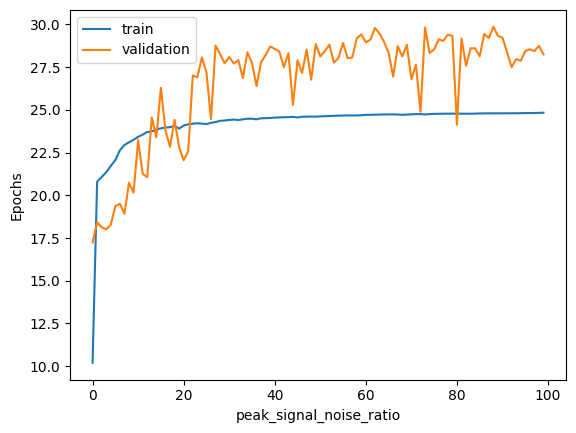

In [74]:
show_metrics(history, "peak_signal_noise_ratio")

In [ ]:
show_metrics(history, "loss")

In [34]:
test_dl = DataLoader(test_dataset, batch_size=64, generator=torch.Generator(device="cpu"))

In [39]:
from skimage.metrics import peak_signal_noise_ratio as psnr

def evaluation(model, test_dataset):

    total_loss = 0
    total_ratio = 0
    
    model = model.to("cpu")
    loss_fn = nn.MSELoss()
    # metrics - psnr
    
    model.eval()
    
    with torch.no_grad():
        for x, y in test_dl:
    
            res = model(x)
            current_loss = loss_fn(y.cpu(), res.cpu())
            total_loss += current_loss.item()
    
    
            current_ratio = psnr(y.cpu().numpy(), res.cpu().numpy())
            total_ratio += current_ratio.item()
         
    
    losses = total_loss / len(test_dl)
    ratios = total_ratio / len(test_dl)
    
    return f"[Loss: [{losses}], Noise ratio: [{ratios}]]"

In [40]:
print(evaluation(model, test_dl))

[Loss: [0.0016043806681409478], Noise ratio: [27.948029373049664]]


In [53]:
import torch
import numpy as np
import matplotlib.pyplot as plt


def results(model, test_dataset):

    model.eval()
    
    model = model.to("cpu")
    
    predictions = []  
    true_labels = [] 
    originals = []
    
    with torch.no_grad():
        for batch in test_dataset: 
            x, y = batch  

            y_pred = model(x)
    
            originals.append(x.cpu().numpy())  
            predictions.append(y_pred.cpu().numpy())
            true_labels.extend(y.cpu().numpy())

    return predictions, true_labels, originals

In [55]:
predictions, true_labels, originals = results(model, test_dl)

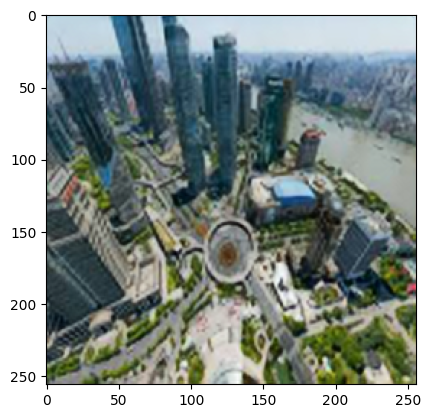

In [57]:
plt.imshow(predictions[0][0].transpose(1, 2, 0))

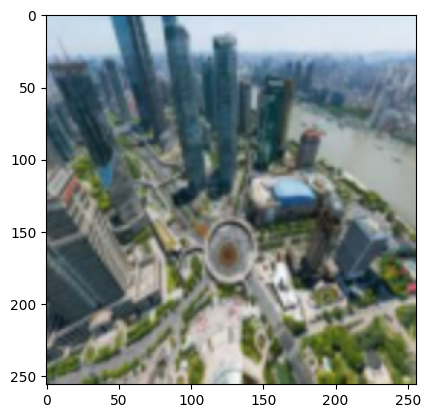

In [58]:
plt.imshow(originals[0][0].transpose(1, 2, 0))

In [59]:
true_labels[0].shape

(3, 256, 256)

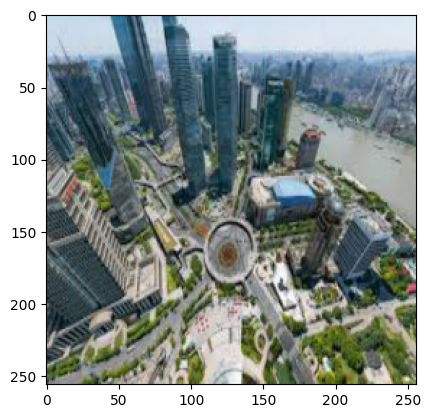

In [60]:
plt.imshow(true_labels[0].transpose(1, 2, 0))

In [63]:
def output_results(num_images, originals, predictions, true_labels):
    num_images = num_images
    
    fig, axes = plt.subplots(num_images, 3, figsize=(30, 30))
    
    for i in range(num_images):
        
        axes[i, 0].imshow(originals[0][i].transpose(1, 2, 0), cmap='gray')
        axes[i, 0].set_title(f'Original Image #{i+1}')
        axes[i, 0].axis('off')
        
        axes[i, 1].imshow(predictions[0][i].transpose(1, 2, 0), cmap='gray')
        axes[i, 1].set_title(f'Restored Image #{i+1}')
        axes[i, 1].axis('off')
    
        axes[i, 2].imshow(true_labels[i].transpose(1, 2, 0), cmap='gray')
        axes[i, 2].set_title(f'Ideal version #{i+1}')
        axes[i, 2].axis('off')
    
    plt.tight_layout()
    plt.show()


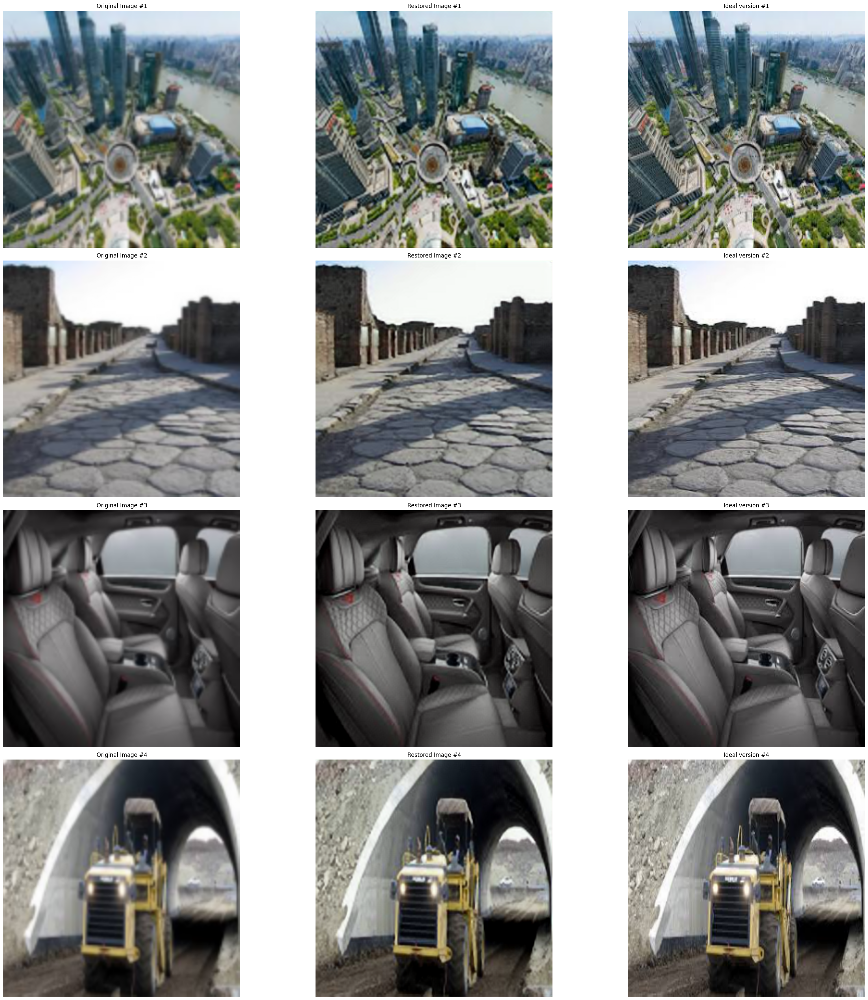

In [64]:
 output_results(4, originals, predictions, true_labels)

In [145]:
torch.save(model.state_dict(), "autoencoder.pt")

In [95]:
# previously I trained model with another optimizer - Adam, which returned better metrics, so now I'll
# download it (model has same structure)

weights = "/kaggle/input/better-model/autoencoder.pt"
new_model = Autoencoder()
new_model.load_state_dict(torch.load(weights))
new_model.to(device)

/tmp/ipykernel_30/1043097021.py:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  new_model.load_state_dict(torch.load(weights))


Autoencoder(
  (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (pool1_1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (pool2_1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv4): Conv2d(256, 512, kernel_size=(3, 3), str

In [96]:
summary(new_model, input_size=(3, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,792
         MaxPool2d-2         [-1, 64, 128, 128]               0
         MaxPool2d-3           [-1, 64, 64, 64]               0
       BatchNorm2d-4           [-1, 64, 64, 64]             128
            Conv2d-5          [-1, 128, 64, 64]          73,856
         MaxPool2d-6          [-1, 128, 32, 32]               0
         MaxPool2d-7          [-1, 128, 16, 16]               0
       BatchNorm2d-8          [-1, 128, 16, 16]             256
            Conv2d-9          [-1, 256, 16, 16]         295,168
        MaxPool2d-10            [-1, 256, 8, 8]               0
      BatchNorm2d-11            [-1, 256, 8, 8]             512
           Conv2d-12            [-1, 512, 8, 8]       1,180,160
        MaxPool2d-13            [-1, 512, 4, 4]               0
        MaxPool2d-14            [-1, 51

In [52]:
print(evaluation(new_model, test_dl))

[Loss: [0.0013715424574911594], Noise ratio: [28.632197686576404]]


In [68]:
new_predictions, new_true_labels, new_originals = results(new_model, test_dl)

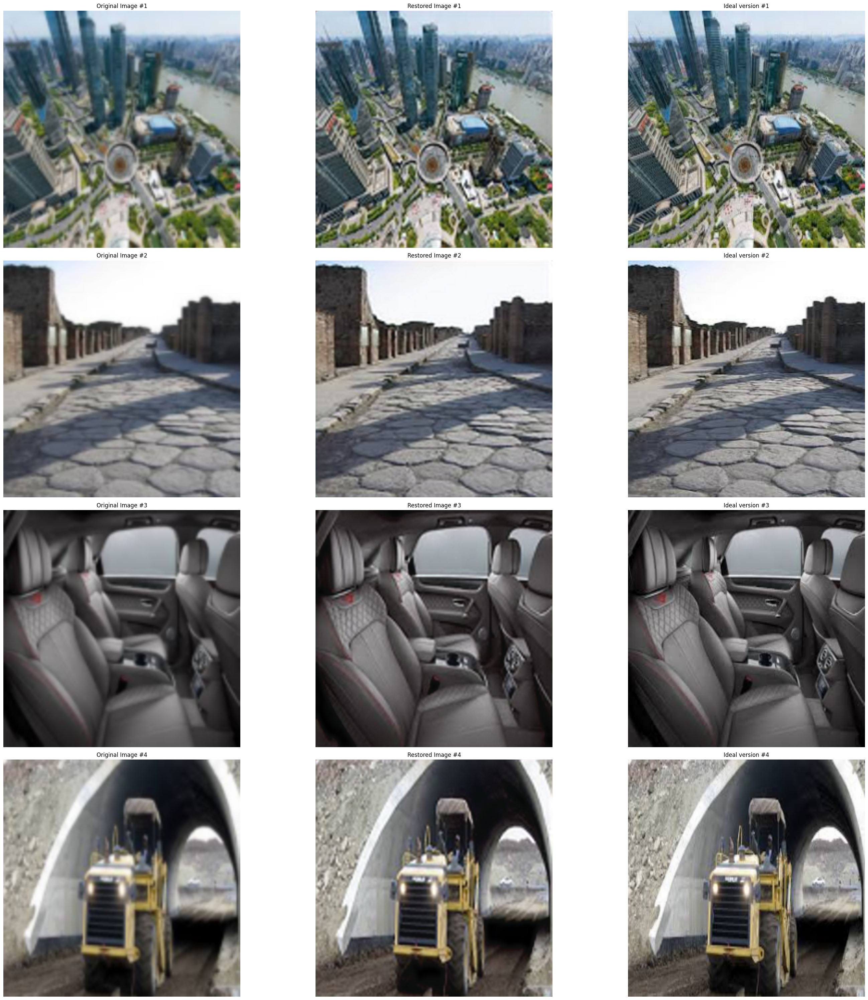

In [69]:
output_results(4, new_originals, new_predictions, new_true_labels)

In [102]:
img = "/kaggle/input/test22/test.jpg"
img = Image.open(img)

new_model = new_model.to("cpu")

transform = transforms.Compose([
    transforms.Resize((256, 256)), 
    transforms.ToTensor(),  
])

img_tensor = transform(img)
img_tensor = img_tensor.to("cpu")

res = new_model.predict(img_tensor)

In [105]:
def output_res(res):
    t_res = res.squeeze(0)
    fin_res = t_res.permute(1, 2, 0)
    plt.imshow(fin_res)
    plt.show()
    

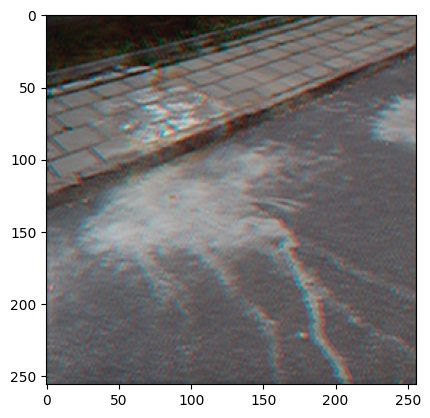

In [106]:
output_res(res)

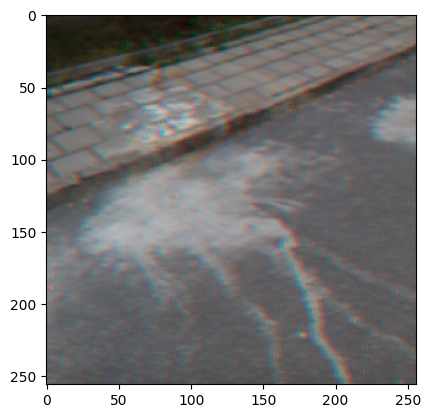

In [107]:
output_res(img_tensor)